# Task 1:
- Input: a set of images with hearts that we corrupted in various ways.
- Output: black&white binary images with black hearts and white background (non-heart areas). 


Dmytro Geleshko

## Imports

In [1]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

## Load images

In [2]:
result = []
images = np.array([cv2.imread("data/hearts " + str(x) +".png") for x in range(1, 11)])
images.shape

(10, 851, 1280, 3)

Function for plotting images later

In [3]:
def plot_image(img, figsize=(16, 9), gray=False):
    plt.rcParams["figure.figsize"] = figsize
    if gray:
        plt.imshow(img, "gray")
    else:
        plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

## Image 1
### Preview

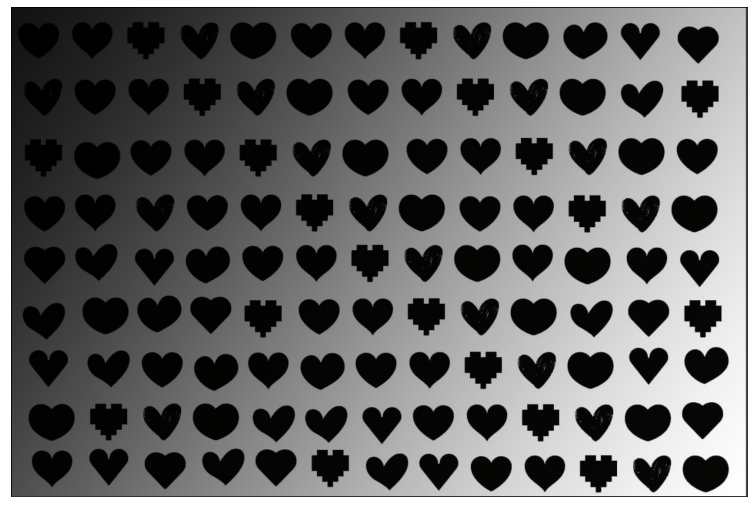

In [4]:
img = images[0].copy()
plot_image(img)

### Adjusting hsv value (and zeroing out the saturation)

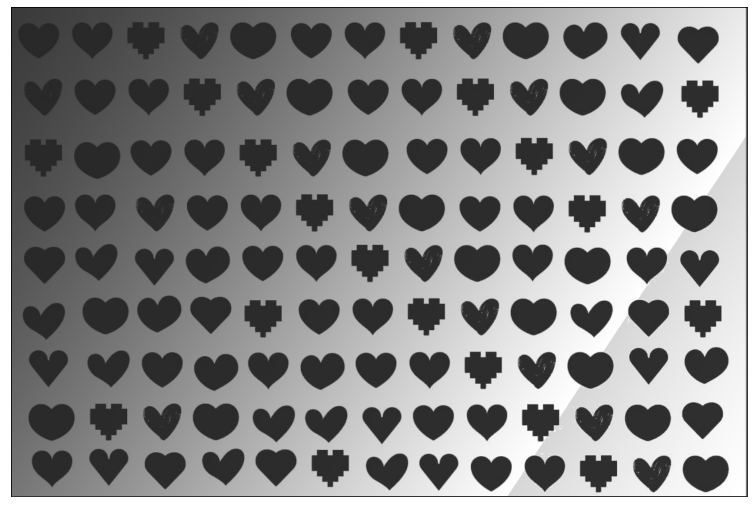

In [5]:
h, s, v = cv2.split(cv2.cvtColor(img, cv2.COLOR_BGR2HSV))
s *= 0
v[v < 255 - 40] += 40
img = cv2.cvtColor(cv2.merge((h, s, v)), cv2.COLOR_HSV2BGR)
plot_image(img)

### Thresholding

In [6]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

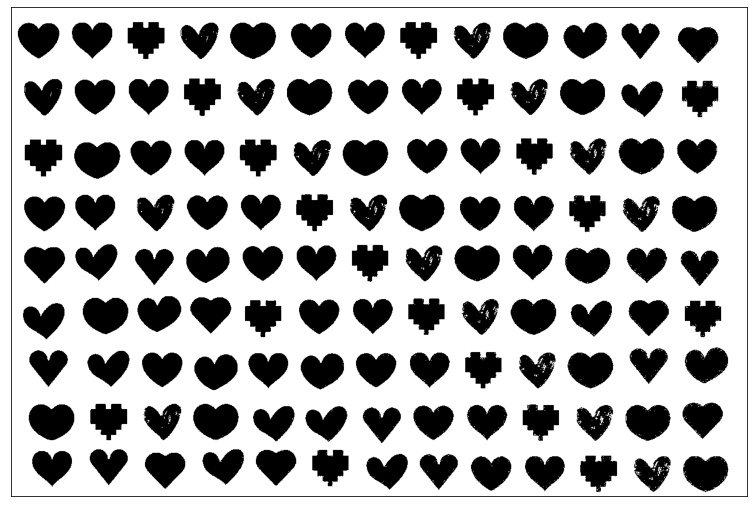

In [7]:
_, th = cv2.threshold(img, 55, 255, cv2.THRESH_BINARY)
plot_image(th, gray=True)

### Morphological transformation (Opening)

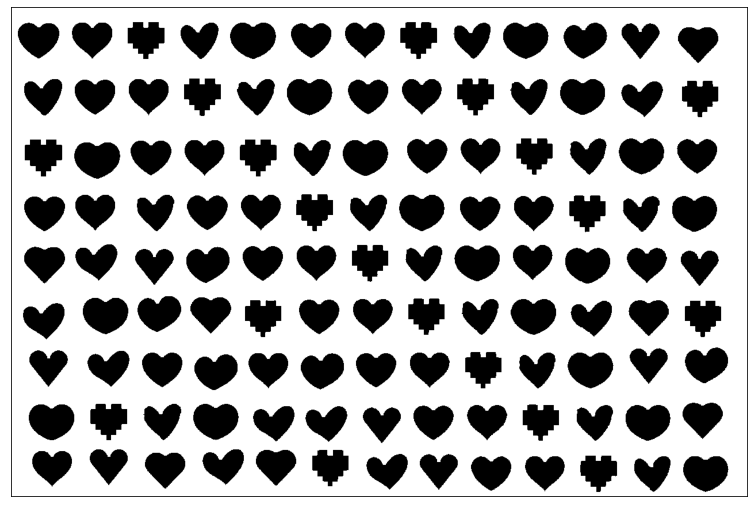

In [8]:
opening = cv2.morphologyEx(th, cv2.MORPH_OPEN, np.ones((5, 5), dtype=np.uint8))
plot_image(opening, gray=True)

In [9]:
result.append(opening.copy())

## Image 2
### Preview

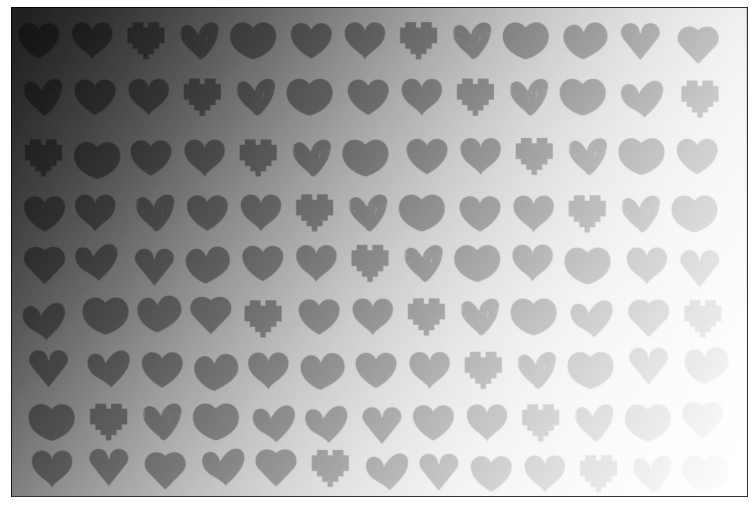

In [10]:
img = images[1].copy()
plot_image(img)

### Applying shadow/highlight (trying to reacreate GIMP function)

In [11]:
def shadow_highlight(img, change, shift_x=0, shift_y=0):
    temp = img.copy()
    center_value = (temp.shape[0] + temp.shape[1]) / 2
    for x in range(temp.shape[0]):
        for y in range(temp.shape[1]):
            coef = (x + shift_x + y + shift_y - center_value) / center_value
            temp[x, y] -= int(coef * change)
    return temp

In [12]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

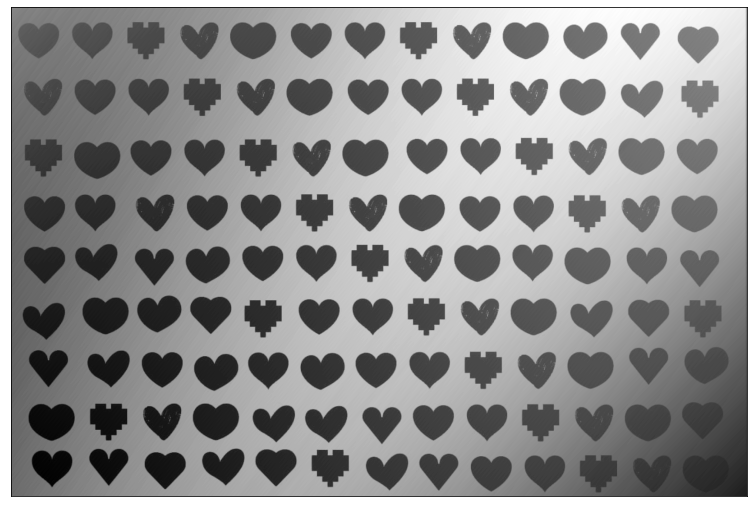

In [13]:
plot_image(shadow_highlight(img, 136, -100, -150), gray=True)

### Adaptive equalization

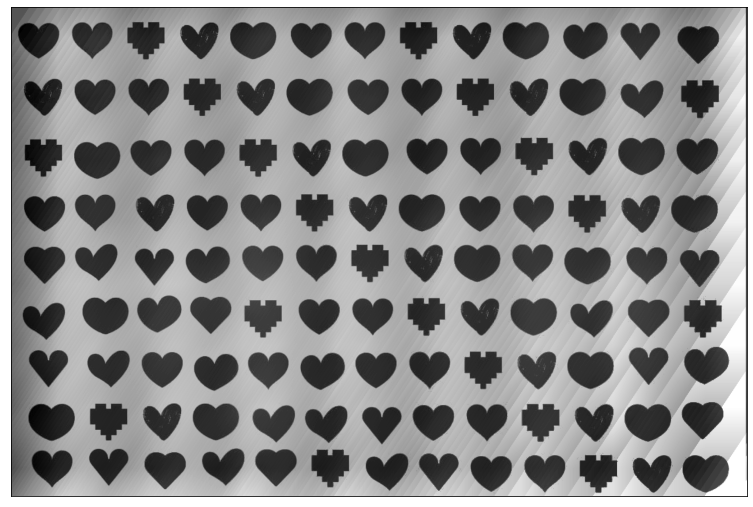

In [14]:
clahe = cv2.createCLAHE(clipLimit=128, tileGridSize=(8, 8))
cl1 = clahe.apply(img)
plot_image(cl1, gray=True)

### Thresholding

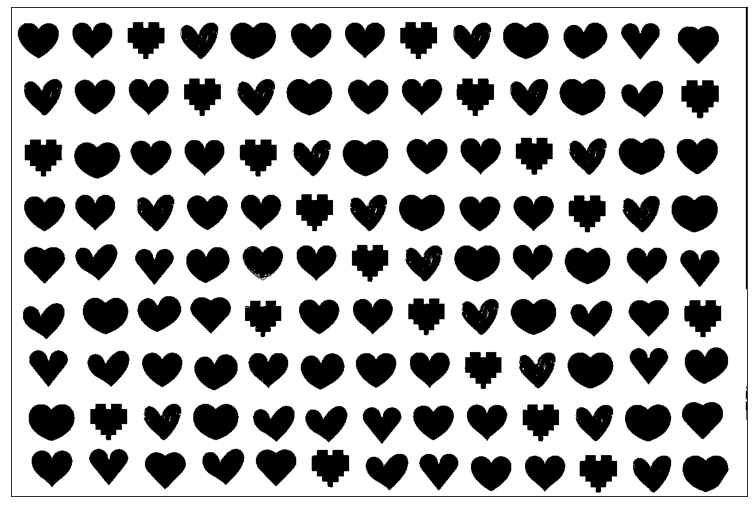

In [15]:
_, th = cv2.threshold(cl1, 72, 255, cv2.THRESH_BINARY)
plot_image(th, gray=True)

### Morphological transformation (Opening)

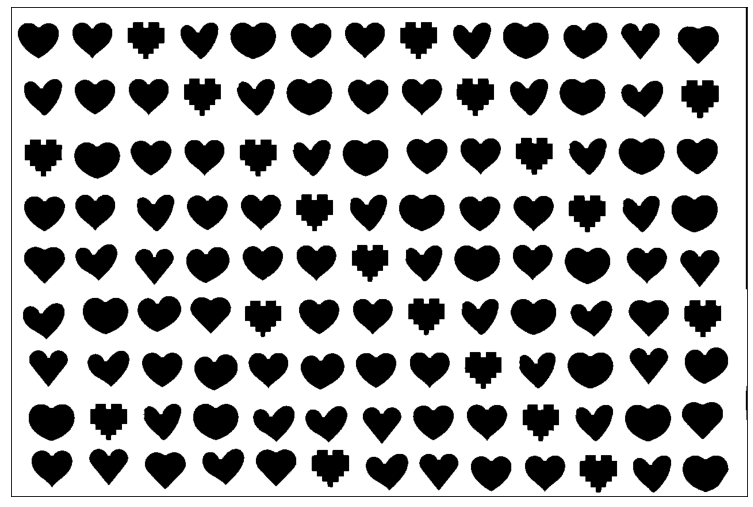

In [16]:
opening = cv2.morphologyEx(th, cv2.MORPH_OPEN, np.ones((5, 5), dtype=np.uint8))
plot_image(opening, gray=True)

In [17]:
result.append(opening.copy())

## Image 3
### Preview

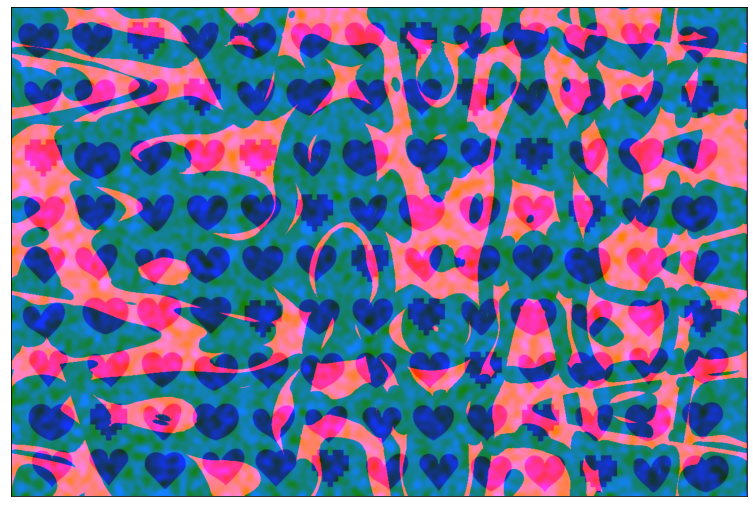

In [18]:
img = images[2].copy()
plot_image(img[:,:,::-1])

### Looking through channels

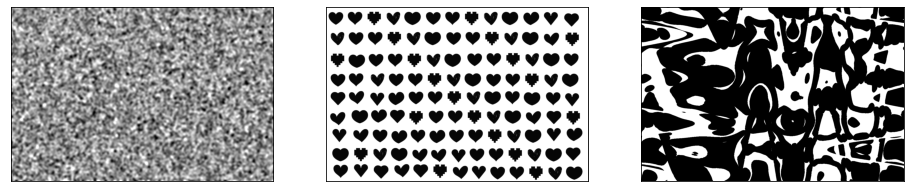

In [19]:
# B
plt.subplot(1, 3, 1)
plot_image(img[:,:,0], gray=True)
#G
plt.subplot(1, 3, 2)
plot_image(img[:,:,1], gray=True)
#R
plt.subplot(1, 3, 3)
plot_image(img[:,:,2], gray=True)

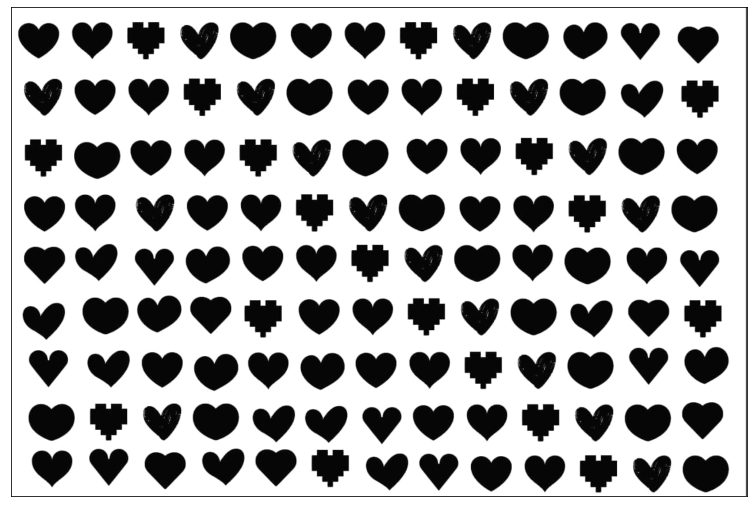

In [20]:
img = img[:, :, 1]
plot_image(img, gray=True)

### Morphological transformation (Opening)

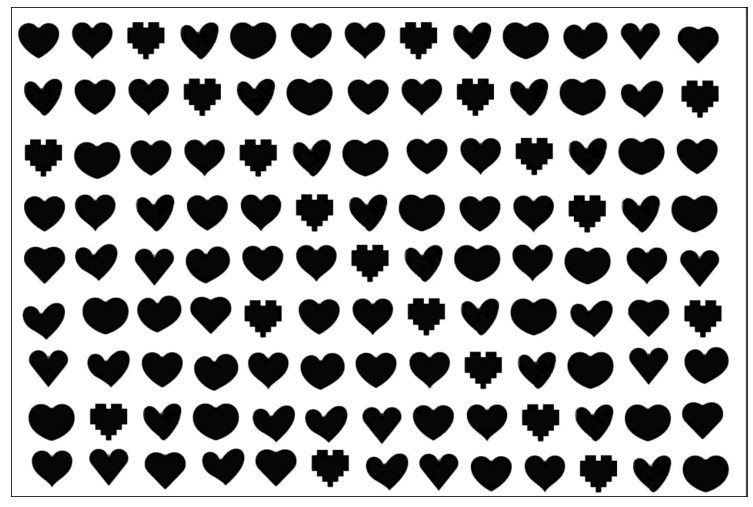

In [21]:
opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, np.ones((5, 5), dtype=np.uint8))
plot_image(opening, gray=True)

### Thresholding (OTSU)

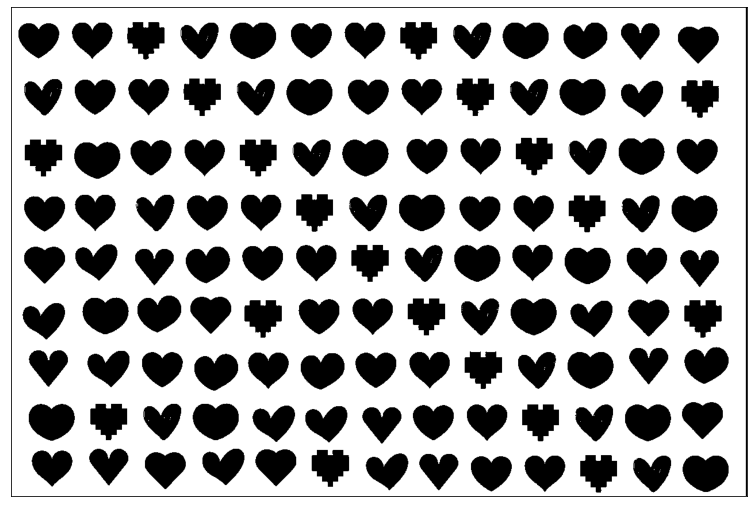

In [22]:
_,th = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
plot_image(th, gray=True)

In [23]:
result.append(th.copy())

## Image 4
### Preview

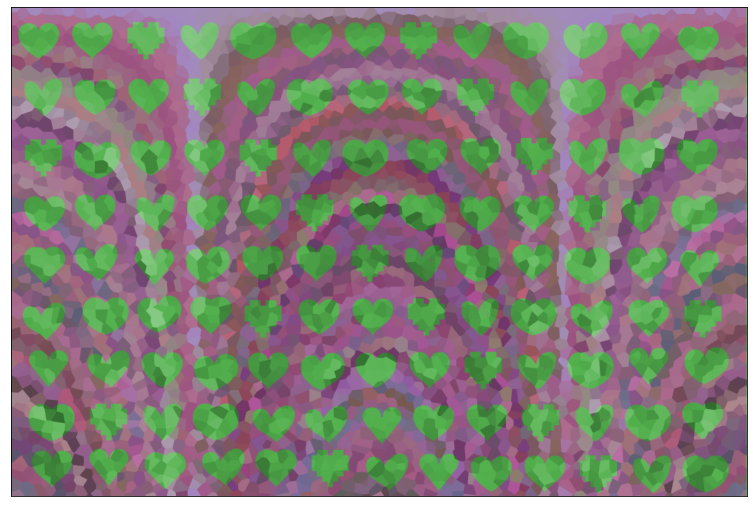

In [24]:
img = images[3].copy()
plot_image(img[:,:,::-1])

### Looking through channels

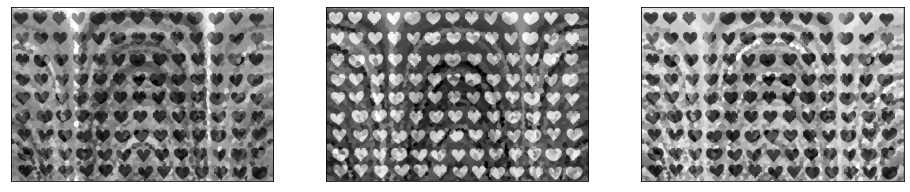

In [25]:
# B
plt.subplot(1, 3, 1)
plot_image(img[:,:,0], gray=True)
#G
plt.subplot(1, 3, 2)
plot_image(img[:,:,1], gray=True)
#R
plt.subplot(1, 3, 3)
plot_image(img[:,:,2], gray=True)

### Inverting one the second (green) channel

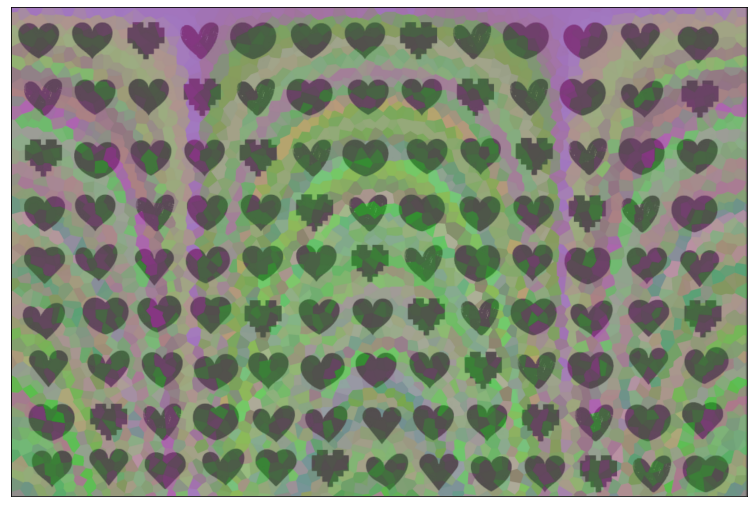

In [26]:
img[:,:,1] = 255 - img[:,:,1]
plot_image(img[:,:,::-1])

### BGR2GRAY

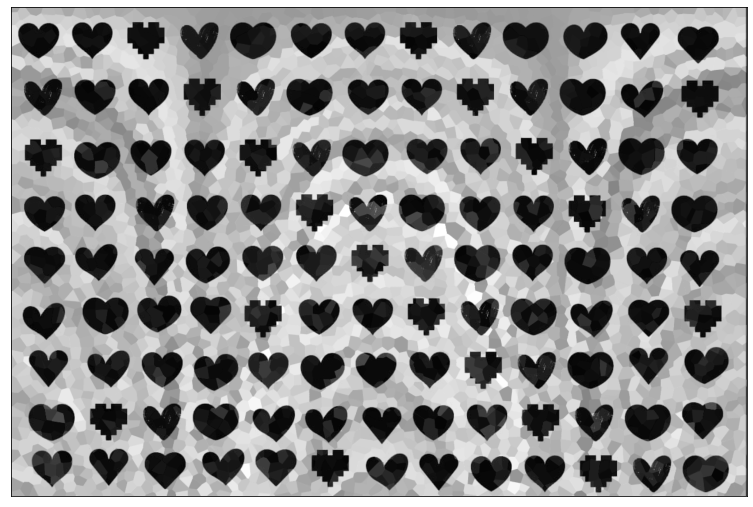

In [27]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plot_image(img, gray=True)

### Thresholding (OTSU)

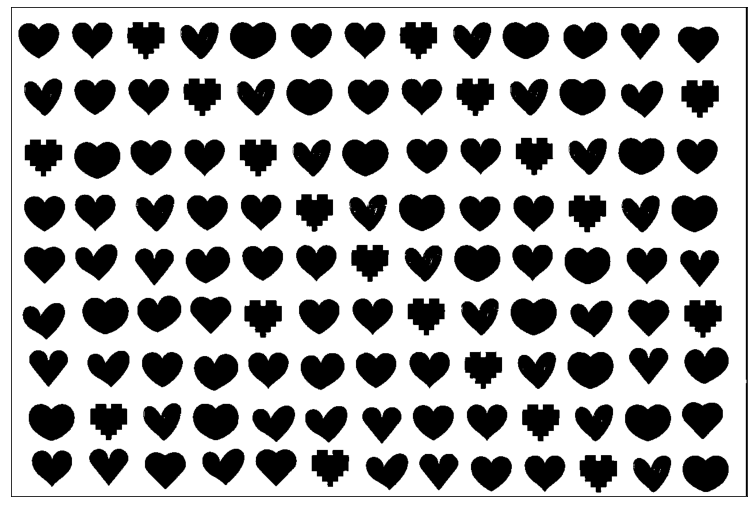

In [28]:
_,th = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
plot_image(th, gray=True)

### Morphological transformation (Opening)

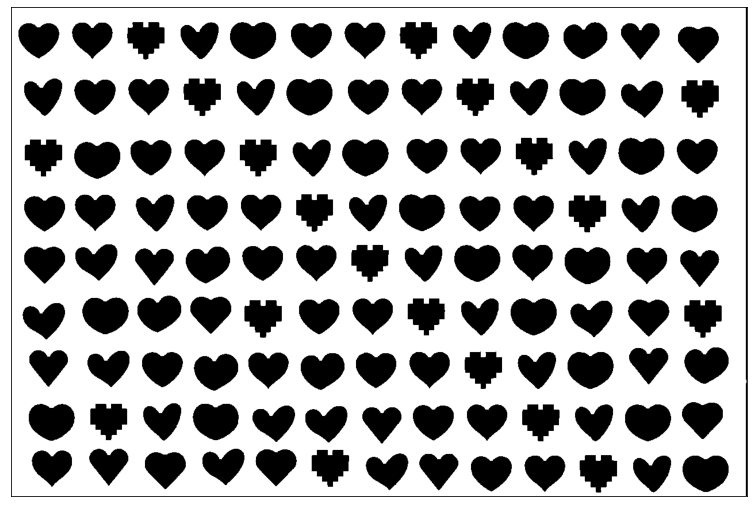

In [29]:
opening = cv2.morphologyEx(th, cv2.MORPH_OPEN, np.ones((5, 5), dtype=np.uint8))
plot_image(opening, gray=True)

In [30]:
result.append(opening.copy())

## Image 5
### Preview

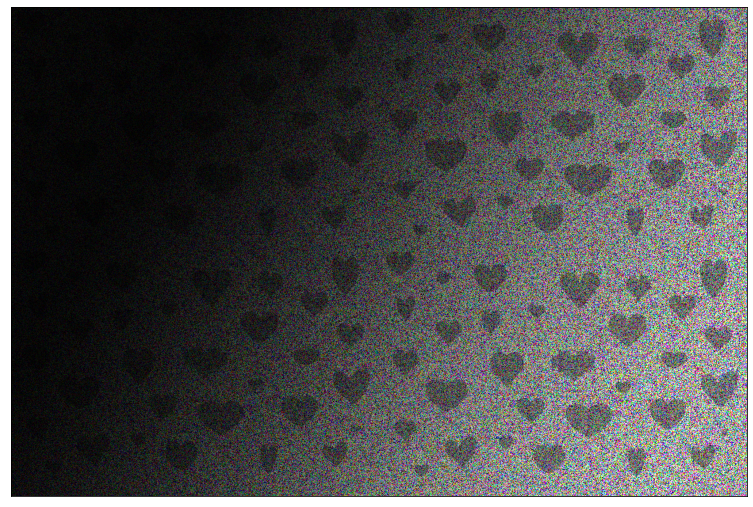

In [31]:
img = images[4].copy()
plot_image(img[:,:,::-1])

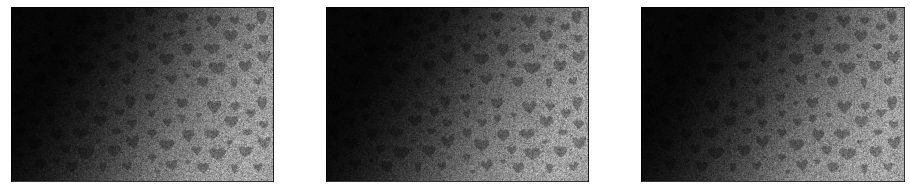

In [32]:
# B
plt.subplot(1, 3, 1)
plot_image(img[:,:,0], gray=True)
#G
plt.subplot(1, 3, 2)
plot_image(img[:,:,1], gray=True)
#R
plt.subplot(1, 3, 3)
plot_image(img[:,:,2], gray=True)

### Adaptive equalization

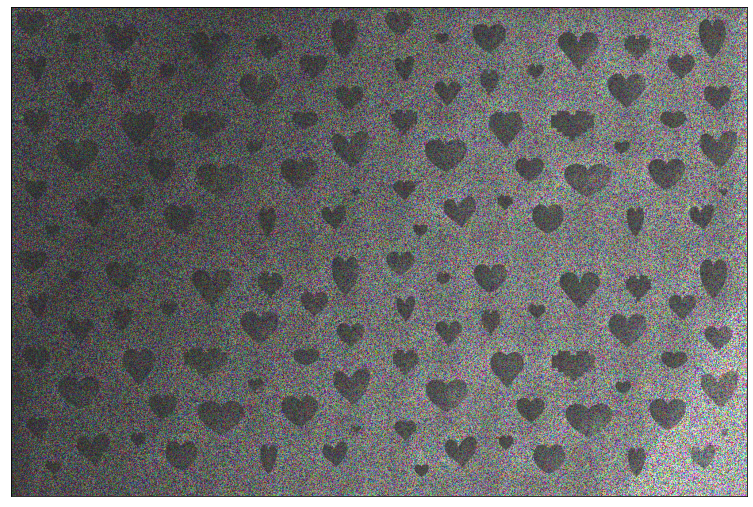

In [33]:
clahe = cv2.createCLAHE(clipLimit=32, tileGridSize=(16, 16))
b, g, r = cv2.split(img)
b, g, r = clahe.apply(b), clahe.apply(g), clahe.apply(r)
img = cv2.merge((b, g, r))
plot_image(img)

### Noise reduction (Morphological closing)

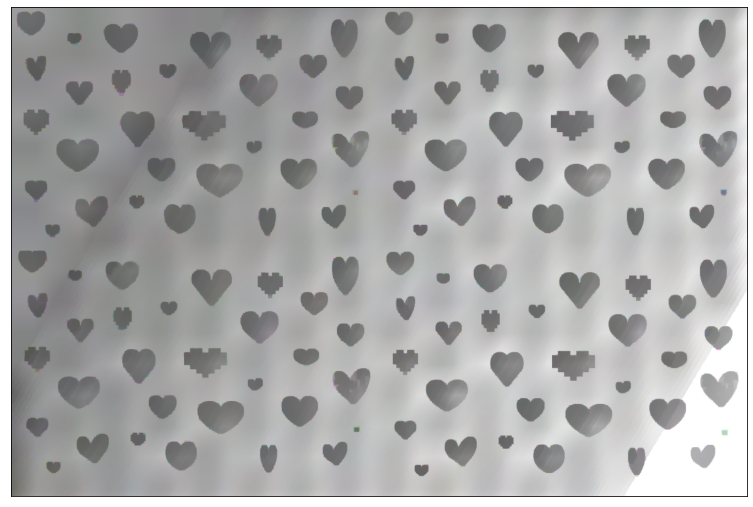

In [34]:
closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, np.ones((7, 7), np.uint8))
plot_image(closing, gray=True)

### Adaptive thresholding

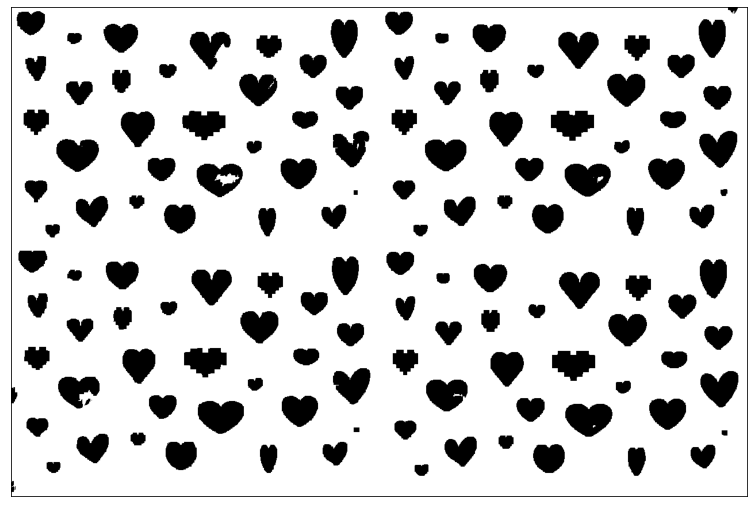

In [35]:
ath = cv2.adaptiveThreshold(cv2.cvtColor(closing, cv2.COLOR_BGR2GRAY), 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 301, 17)
plot_image(ath, gray=True)

### Morphological transformation (Opening)

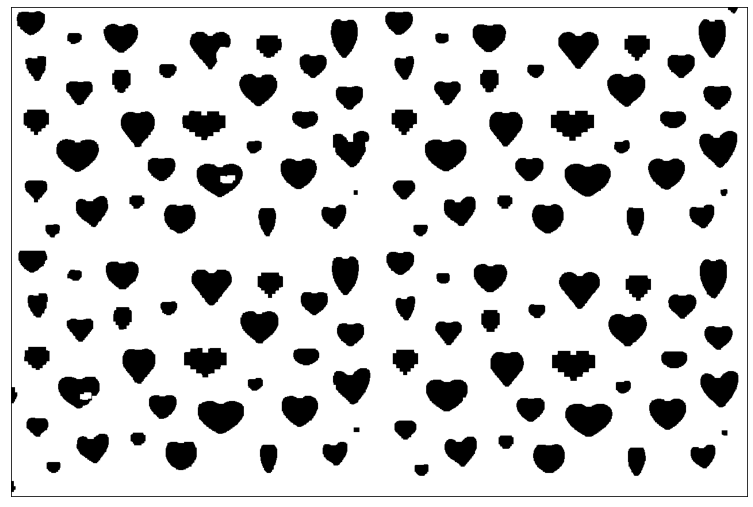

In [36]:
opening = cv2.morphologyEx(ath, cv2.MORPH_OPEN, np.ones((9, 9), np.uint8))
plot_image(opening, gray=True)

In [37]:
result.append(opening.copy())

## Image  6
### Preview

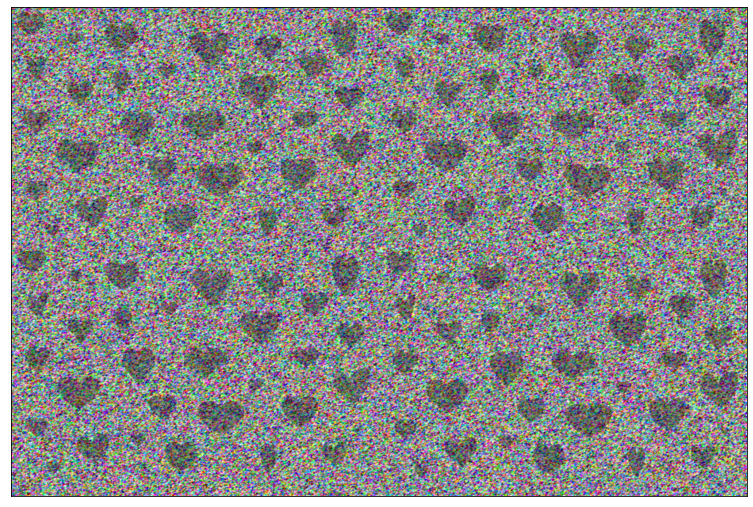

In [38]:
img = images[5].copy()
plot_image(img[:, :, ::-1])

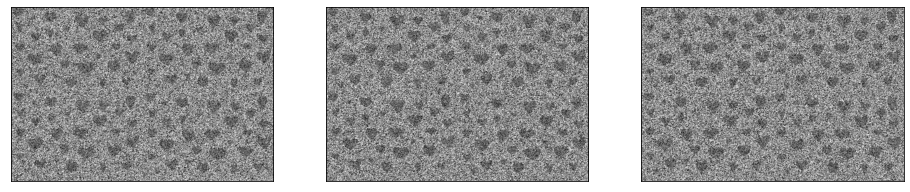

In [39]:
# B
plt.subplot(1, 3, 1)
plot_image(img[:,:,0], gray=True)
#G
plt.subplot(1, 3, 2)
plot_image(img[:,:,1], gray=True)
#R
plt.subplot(1, 3, 3)
plot_image(img[:,:,2], gray=True)

### Removing the saturation

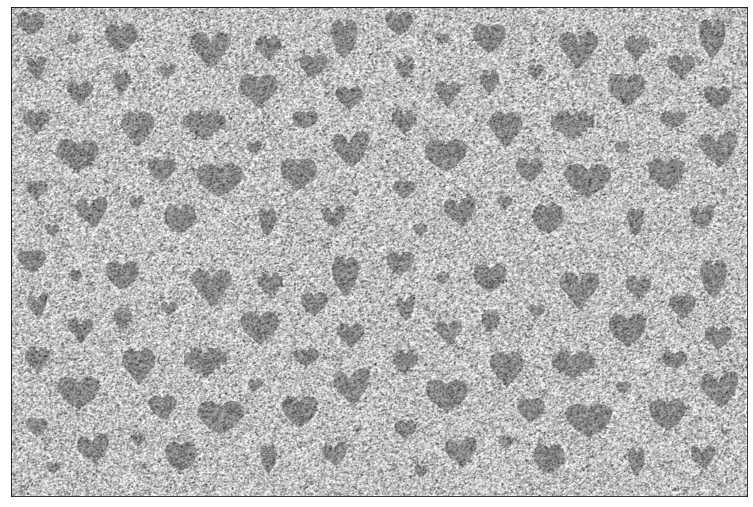

In [40]:
h, s, v = cv2.split(cv2.cvtColor(img, cv2.COLOR_BGR2HSV))
s[:, :] = 0
img = cv2.cvtColor(cv2.merge((h, s, v)), cv2.COLOR_HSV2BGR)
plot_image(img)

### Global equalization

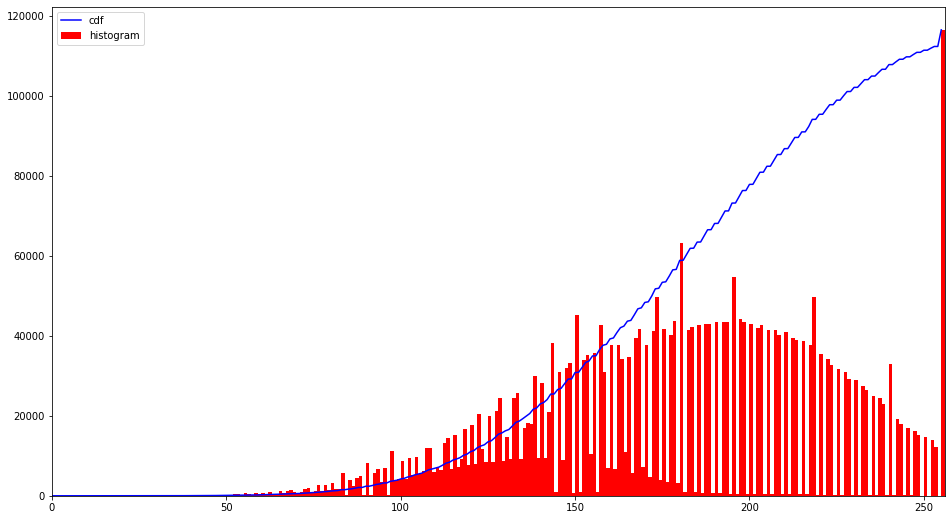

In [41]:
hist, bins = np.histogram(img.flatten(), 256, [0, 256])
cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()
plt.plot(cdf_normalized, color = "b")
plt.hist(img.flatten(), 256, [0, 256], color = "r")
plt.xlim([0, 256])
plt.legend(("cdf","histogram"), loc = "upper left")
plt.show()

In [42]:
cdf_m = np.ma.masked_equal(cdf, 0)
cdf_m = (cdf_m - cdf_m.min()) * 255 / (cdf_m.max() - cdf_m.min())
cdf = np.ma.filled(cdf_m, 0).astype(np.uint8)

img = cdf[img]

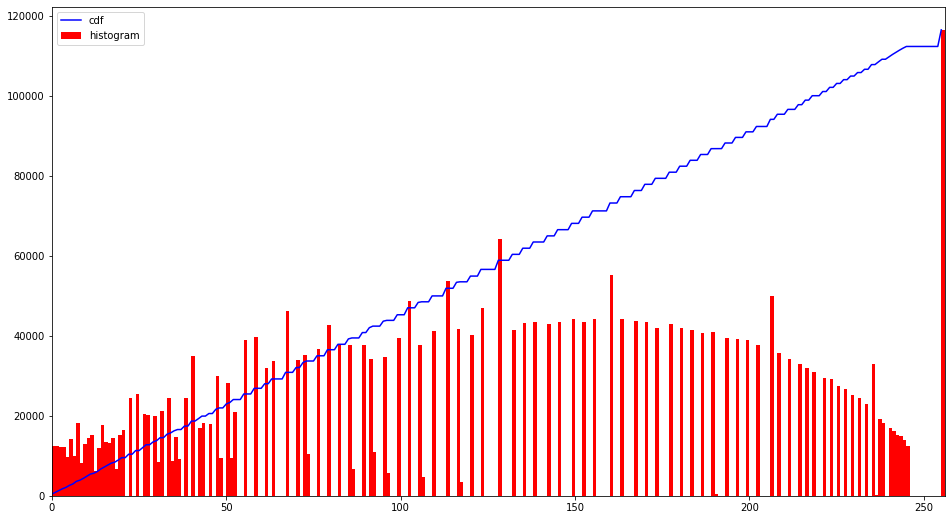

In [43]:
hist, bins = np.histogram(img.flatten(), 256, [0, 256])
cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()
plt.plot(cdf_normalized, color = "b")
plt.hist(img.flatten(), 256, [0, 256], color = "r")
plt.xlim([0, 256])
plt.legend(("cdf","histogram"), loc = "upper left")
plt.show()

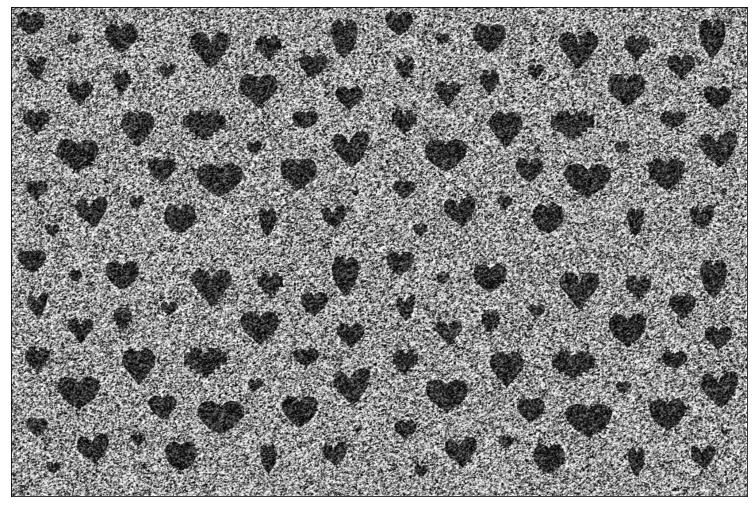

In [44]:
plot_image(img)

### Noise reduction (Morphological transformations)

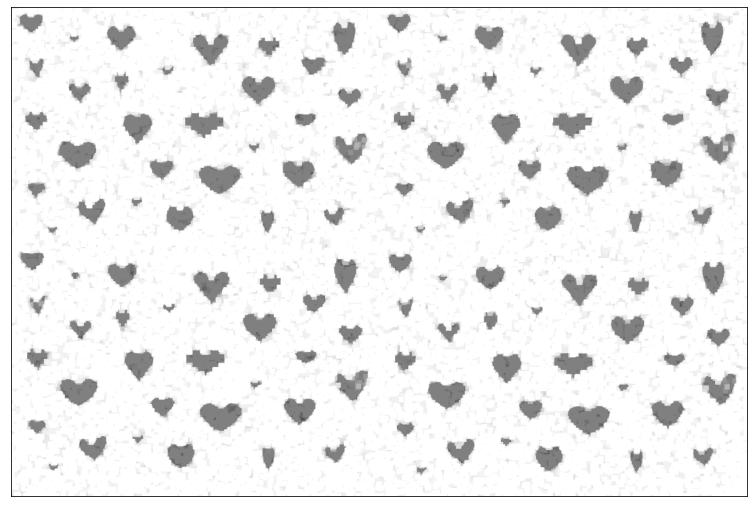

In [45]:
dilation = cv2.dilate(img, np.ones((9, 9), np.uint8), iterations = 1)
plot_image(dilation, gray=True)

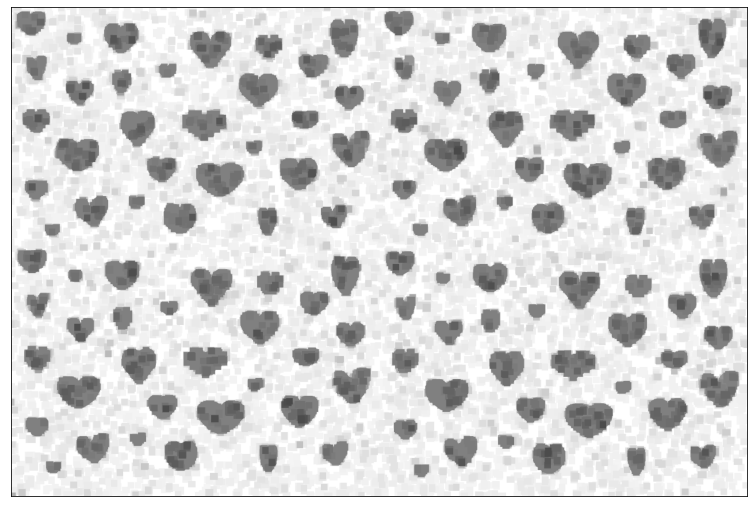

In [46]:
erosion = cv2.erode(dilation, np.ones((3, 3),np.uint8), iterations = 5)
plot_image(erosion, gray=True)

### Thresholding (OTSU)

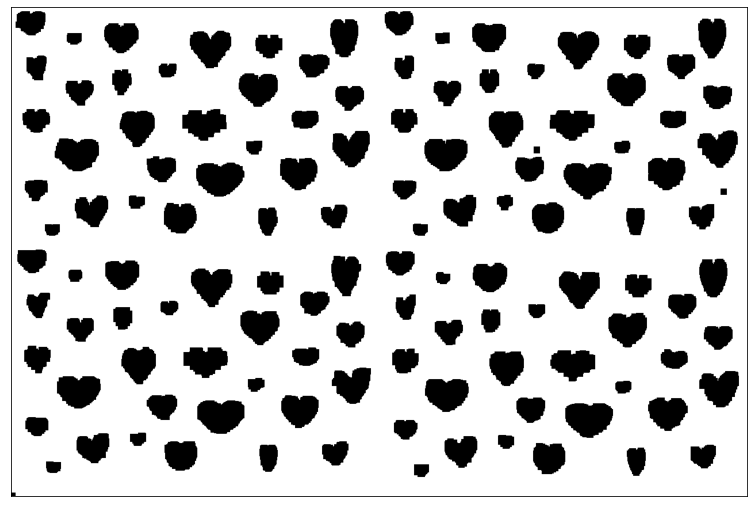

In [47]:
_,th = cv2.threshold(cv2.cvtColor(erosion, cv2.COLOR_BGR2GRAY), 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
plot_image(th, gray=True)

In [48]:
result.append(th.copy())

## Image 7
### Preview

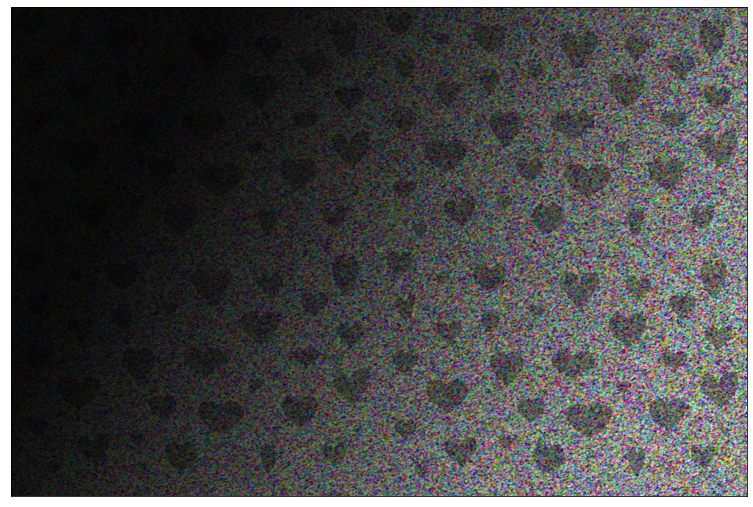

In [49]:
img = images[6].copy()
plot_image(img[:,:,::-1])

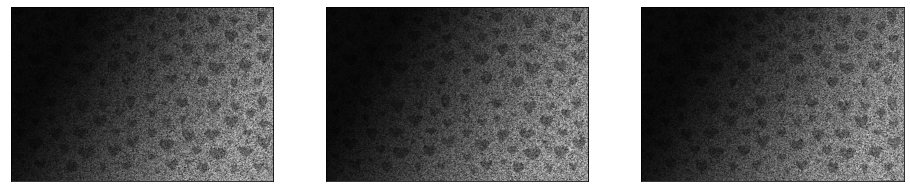

In [50]:
# B
plt.subplot(1, 3, 1)
plot_image(img[:,:,0], gray=True)
#G
plt.subplot(1, 3, 2)
plot_image(img[:,:,1], gray=True)
#R
plt.subplot(1, 3, 3)
plot_image(img[:,:,2], gray=True)

### Adaptive equalization

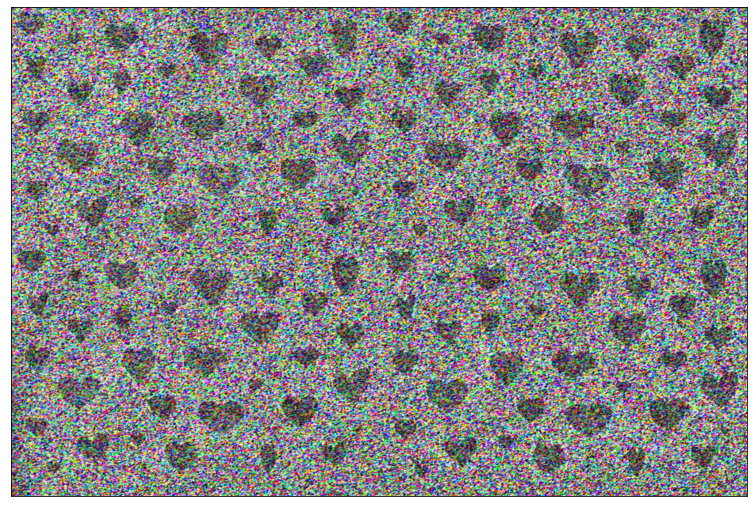

In [51]:
clahe = cv2.createCLAHE(clipLimit=32, tileGridSize=(16, 16))
b, g, r = cv2.split(img)
b, g, r = clahe.apply(b), clahe.apply(g), clahe.apply(r)
img = cv2.merge((b, g, r))
plot_image(img)

### Removing the saturation

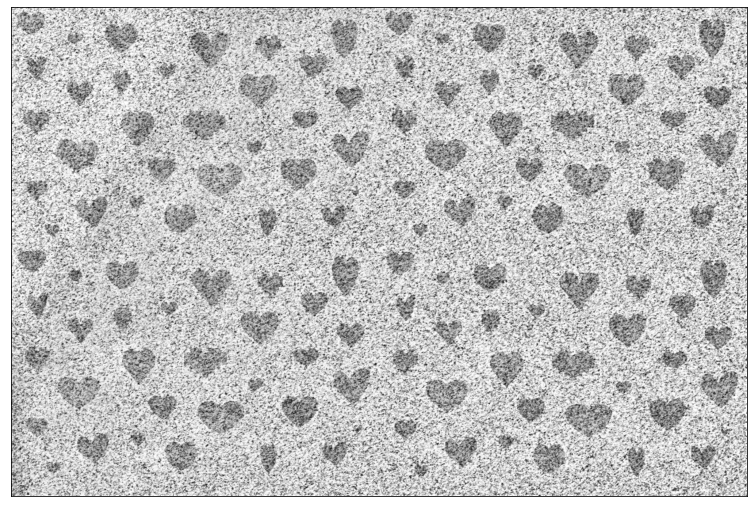

In [52]:
h, s, v = cv2.split(cv2.cvtColor(img, cv2.COLOR_BGR2HSV))
s[:, :] = 0
img = cv2.cvtColor(cv2.merge((h, s, v)), cv2.COLOR_HSV2BGR)
plot_image(img)

### Global equalization

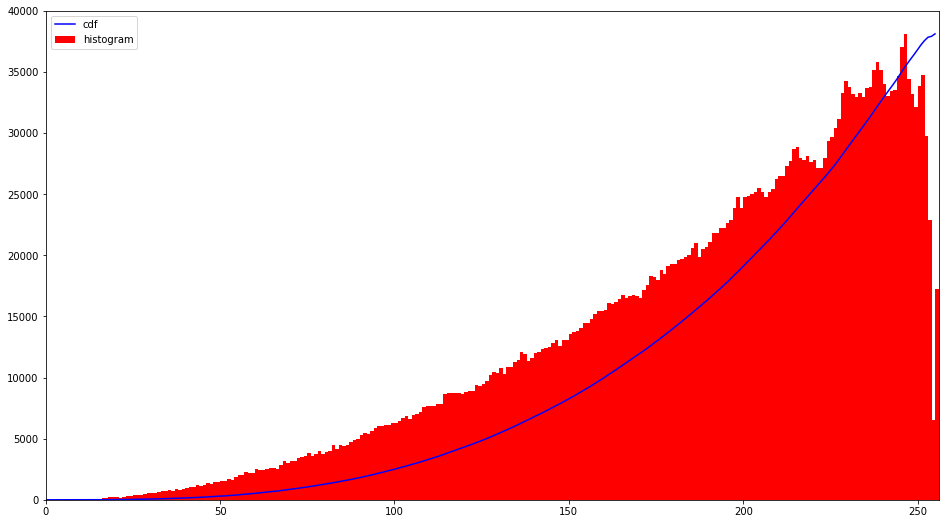

In [53]:
hist, bins = np.histogram(img.flatten(), 256, [0, 256])
cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()
plt.plot(cdf_normalized, color = "b")
plt.hist(img.flatten(), 256, [0, 256], color = "r")
plt.xlim([0, 256])
plt.legend(("cdf","histogram"), loc = "upper left")
plt.show()

In [54]:
cdf_m = np.ma.masked_equal(cdf, 0)
cdf_m = (cdf_m - cdf_m.min()) * 255 / (cdf_m.max() - cdf_m.min())
cdf = np.ma.filled(cdf_m, 0).astype(np.uint8)

img = cdf[img]

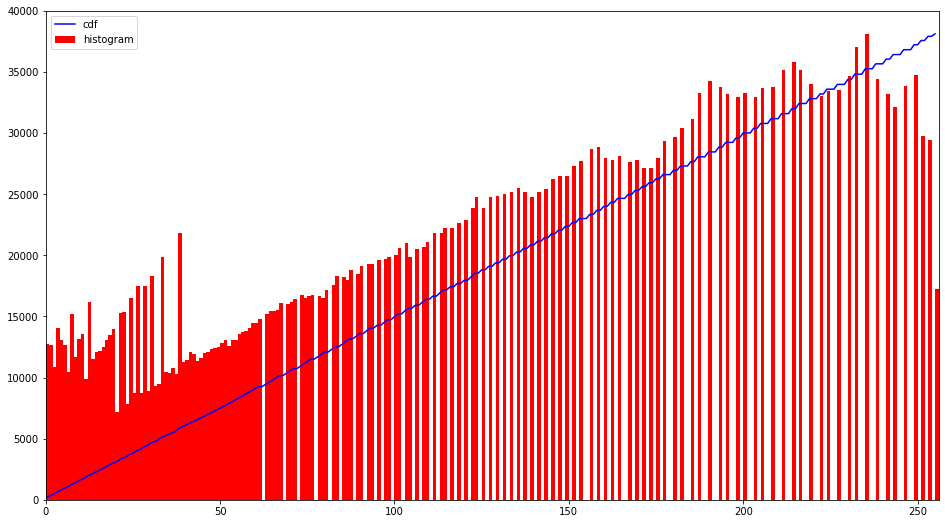

In [55]:
hist, bins = np.histogram(img.flatten(), 256, [0, 256])
cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()
plt.plot(cdf_normalized, color = "b")
plt.hist(img.flatten(), 256, [0, 256], color = "r")
plt.xlim([0, 256])
plt.legend(("cdf","histogram"), loc = "upper left")
plt.show()

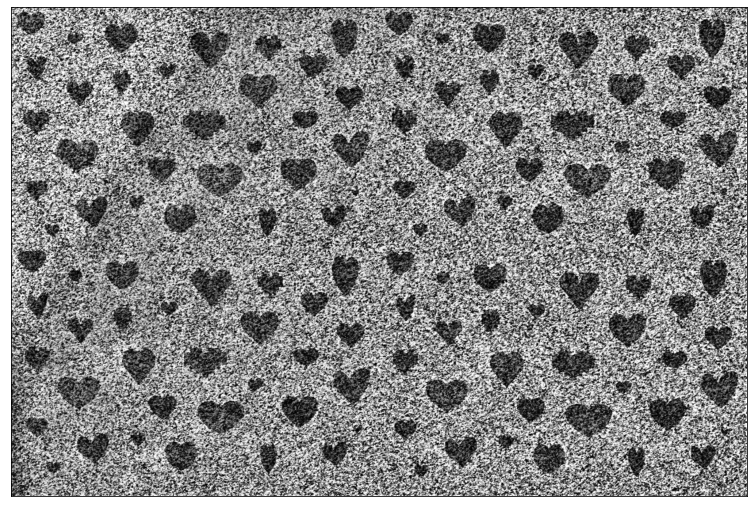

In [56]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plot_image(img, gray=True)

### Noise reduction (Morphological closing)

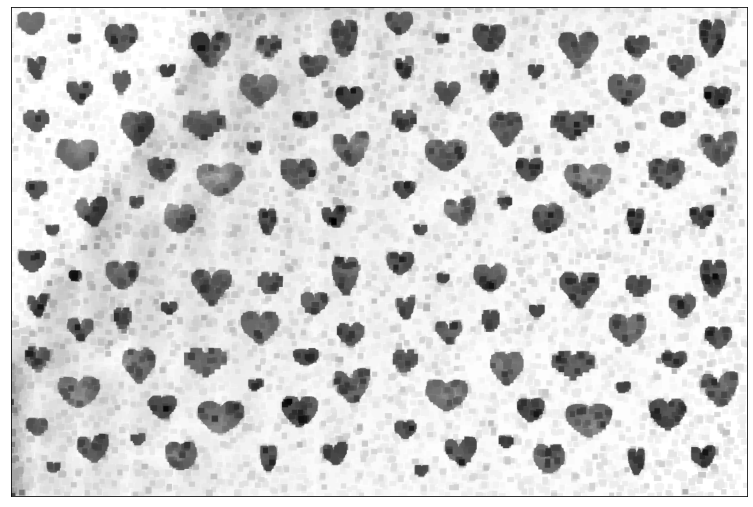

In [57]:
closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, np.ones((9, 9), np.uint8))
plot_image(closing, gray=True)

### Thresholding (OTSU)

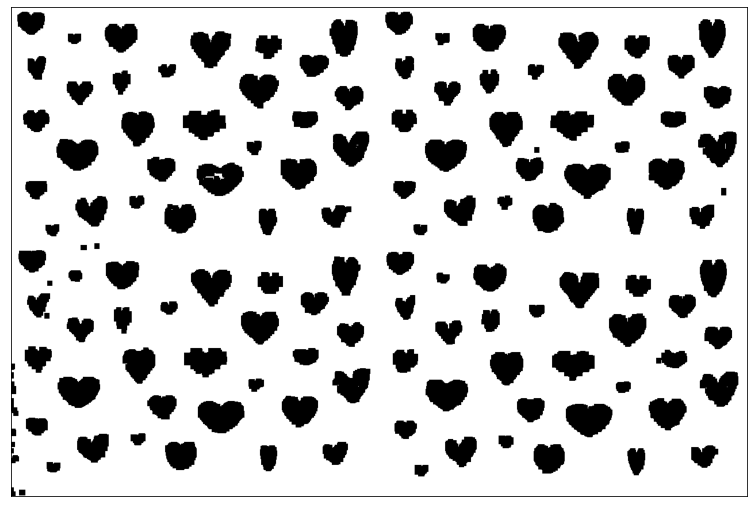

In [58]:
_,th = cv2.threshold(closing, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
plot_image(th, gray=True)

### Morphological transformation (Opening)

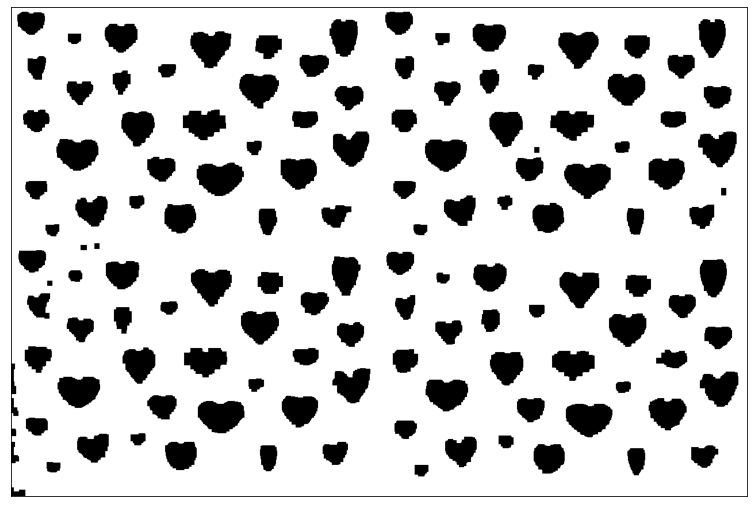

In [59]:
opening = cv2.morphologyEx(th, cv2.MORPH_OPEN, np.ones((7, 7), np.uint8))
plot_image(opening, gray=True)

In [60]:
result.append(opening.copy())

## Image 8
### Preview

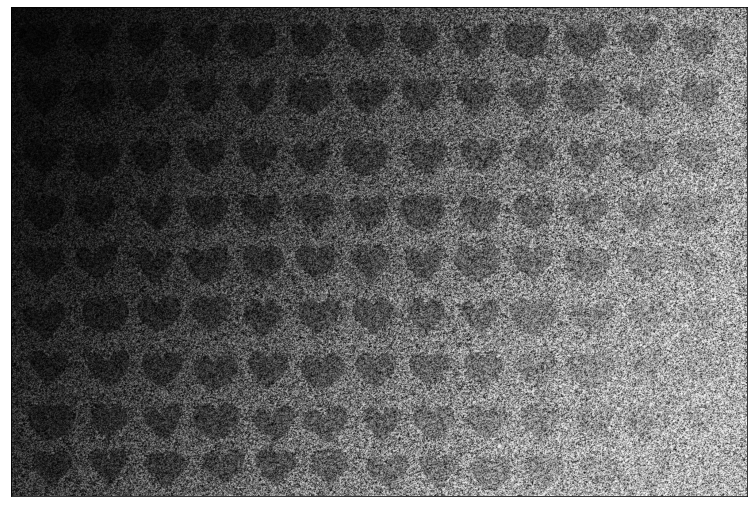

In [61]:
img = images[7].copy()
plot_image(img[:,:,::-1])

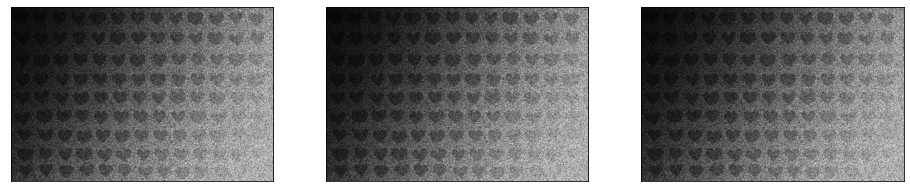

In [62]:
# B
plt.subplot(1, 3, 1)
plot_image(img[:,:,0], gray=True)
#G
plt.subplot(1, 3, 2)
plot_image(img[:,:,1], gray=True)
#R
plt.subplot(1, 3, 3)
plot_image(img[:,:,2], gray=True)

### Adaptive equalization

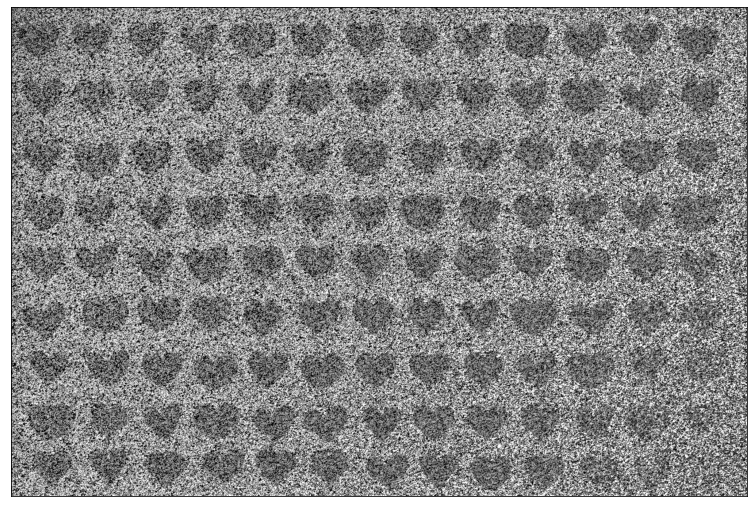

In [63]:
clahe = cv2.createCLAHE(clipLimit=16, tileGridSize=(13, 9))
b, g, r = cv2.split(img)
b, g, r = clahe.apply(b), clahe.apply(g), clahe.apply(r)
img = cv2.merge((b, g, r))
plot_image(img)

### Removing the saturation

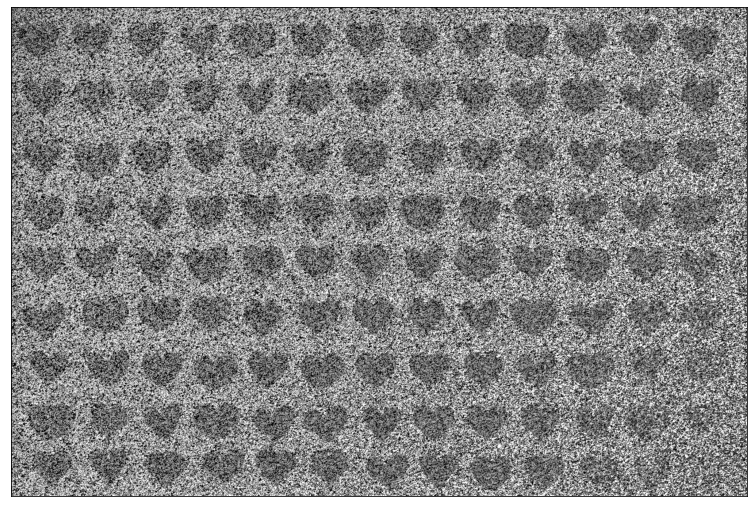

In [64]:
h, s, v = cv2.split(cv2.cvtColor(img, cv2.COLOR_BGR2HSV))
s[:, :] = 0
img = cv2.cvtColor(cv2.merge((h, s, v)), cv2.COLOR_HSV2BGR)
plot_image(img)

### Global equalization

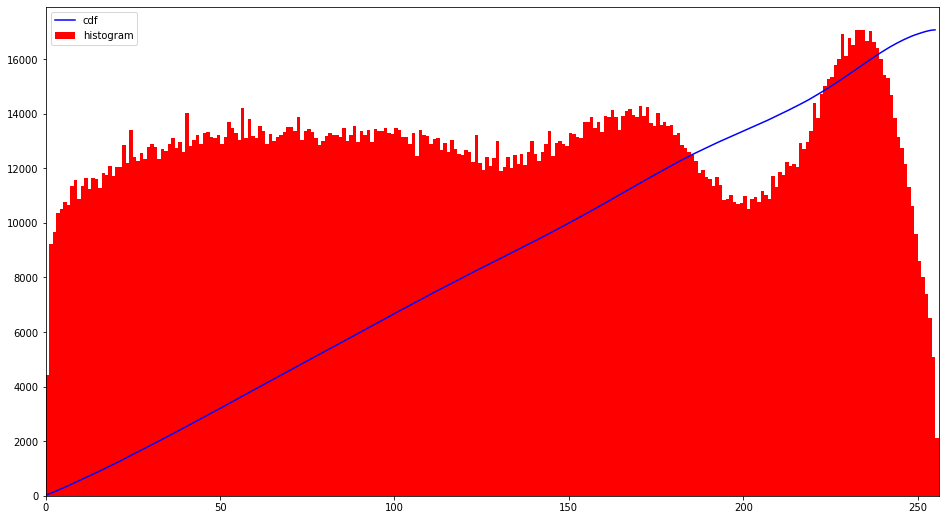

In [65]:
hist, bins = np.histogram(img.flatten(), 256, [0, 256])
cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()
plt.plot(cdf_normalized, color = "b")
plt.hist(img.flatten(), 256, [0, 256], color = "r")
plt.xlim([0, 256])
plt.legend(("cdf","histogram"), loc = "upper left")
plt.show()

In [66]:
cdf_m = np.ma.masked_equal(cdf, 0)
cdf_m = (cdf_m - cdf_m.min()) * 255 / (cdf_m.max() - cdf_m.min())
cdf = np.ma.filled(cdf_m, 0).astype(np.uint8)

img = cdf[img]

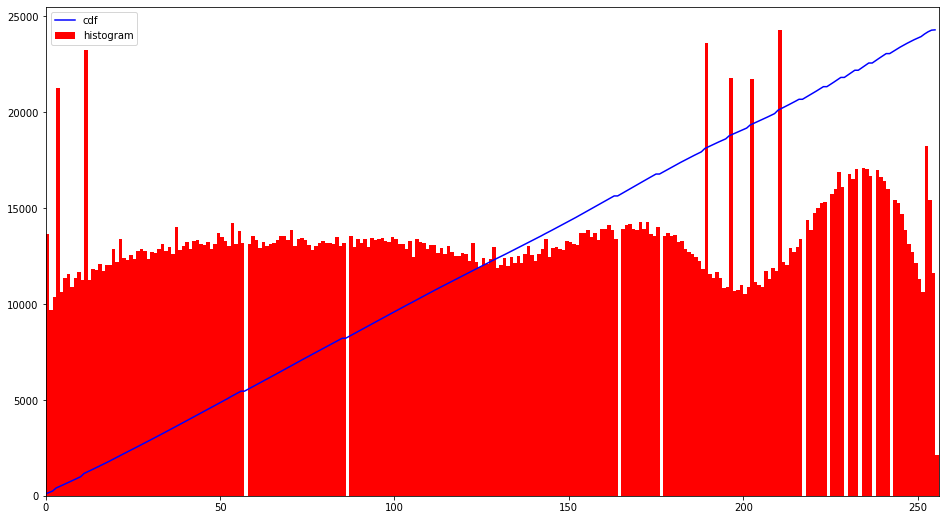

In [67]:
hist, bins = np.histogram(img.flatten(), 256, [0, 256])
cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()
plt.plot(cdf_normalized, color = "b")
plt.hist(img.flatten(), 256, [0, 256], color = "r")
plt.xlim([0, 256])
plt.legend(("cdf","histogram"), loc = "upper left")
plt.show()

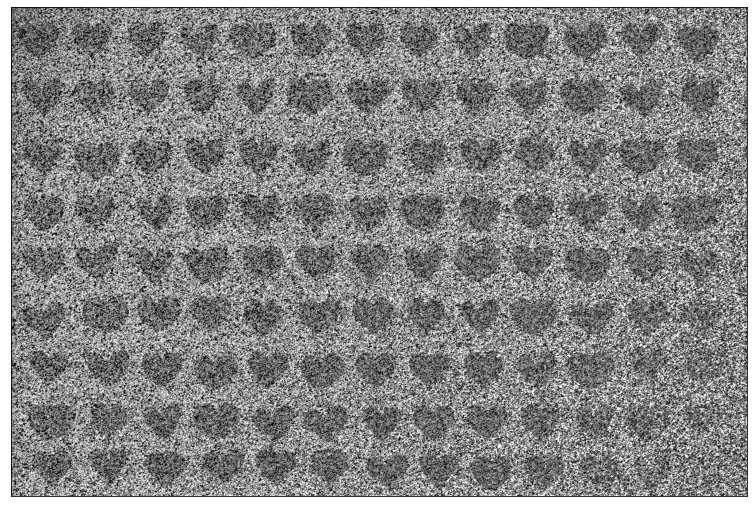

In [68]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plot_image(img, gray=True)

### Noise reduction (Morphological closing)

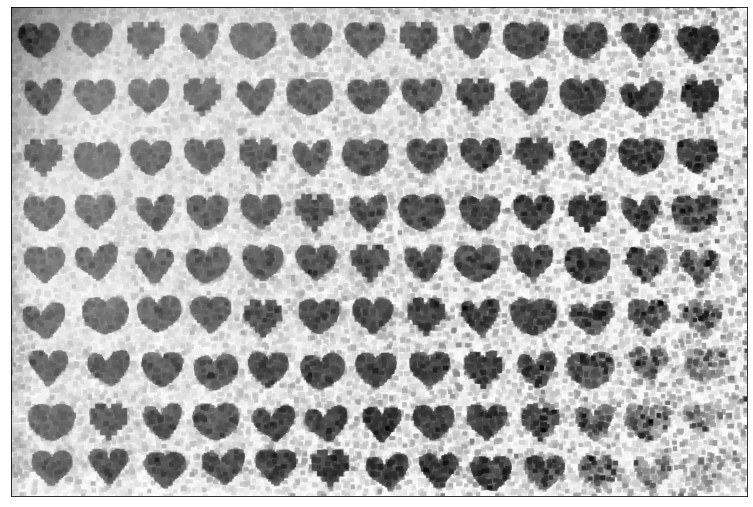

In [69]:
closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, np.ones((7, 7), np.uint8))
plot_image(closing, gray=True)

### Adaptive thresholding

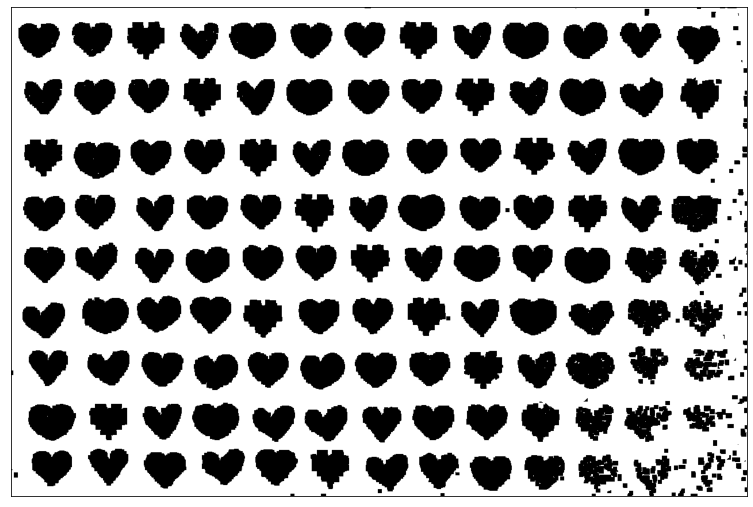

In [70]:
ath = cv2.adaptiveThreshold(closing, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 121, 17)
plot_image(ath, gray=True)

### Noise reduction (Morphological closing)

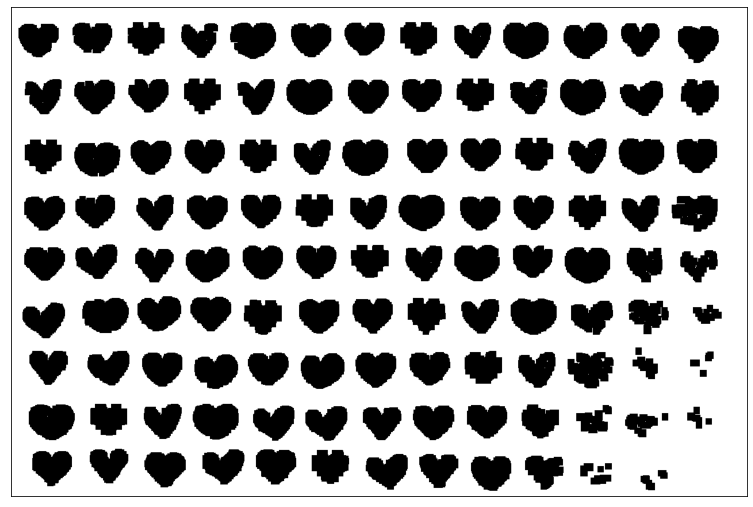

In [71]:
closing = cv2.morphologyEx(ath, cv2.MORPH_CLOSE, np.ones((11, 11), np.uint8))
plot_image(closing, gray=True)

In [72]:
result.append(closing.copy())

## Image 9
### Preview

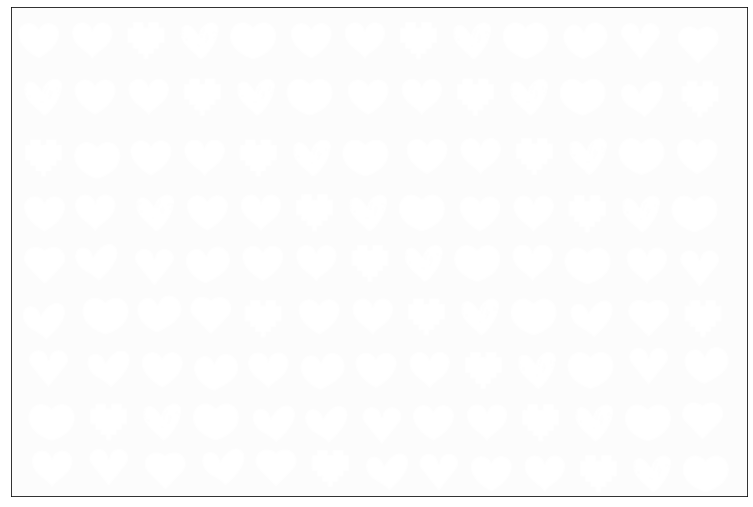

In [73]:
img = images[8].copy()
plot_image(img[:,:,::-1])

### Thresholding (OTSU)

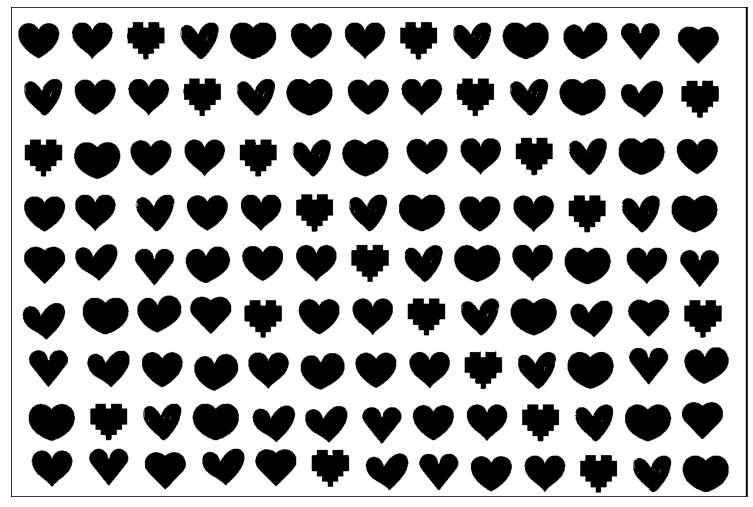

In [74]:
_,th = cv2.threshold(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY), 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
plot_image(th, gray=True)

In [75]:
result.append(th.copy())

## Image 10
### Preview

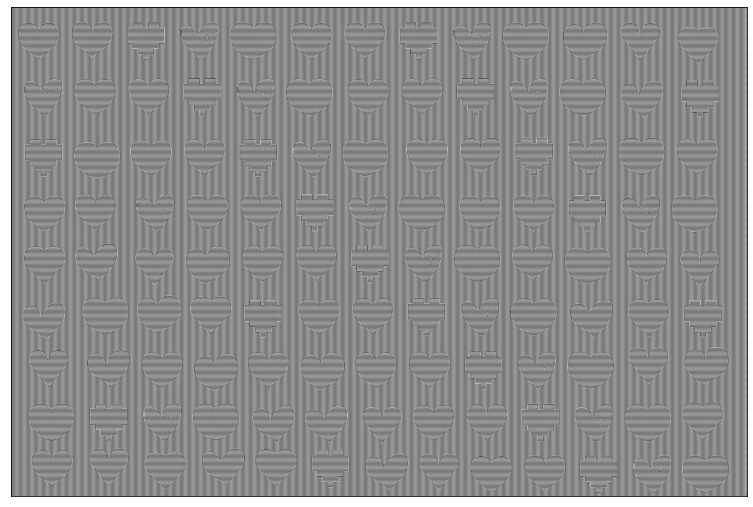

In [76]:
img = images[9].copy()
plot_image(img[:,:,::-1])

### Detecting edges

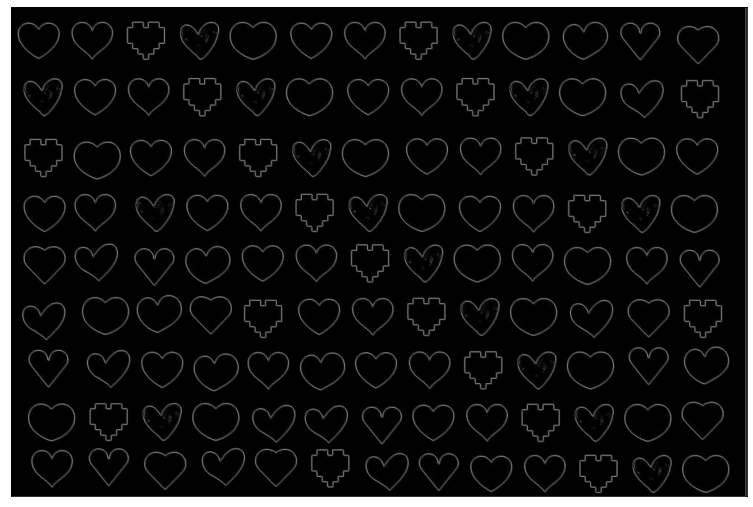

In [77]:
sobelx64f1 = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=3)
sobelx64f2 = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=3)
sobels = np.absolute(sobelx64f1 + sobelx64f2)

sobels = cv2.cvtColor((sobels / sobels.max() * 255).astype(np.uint8), cv2.COLOR_BGR2GRAY)

plot_image(sobels, gray=True)

### Filling the background

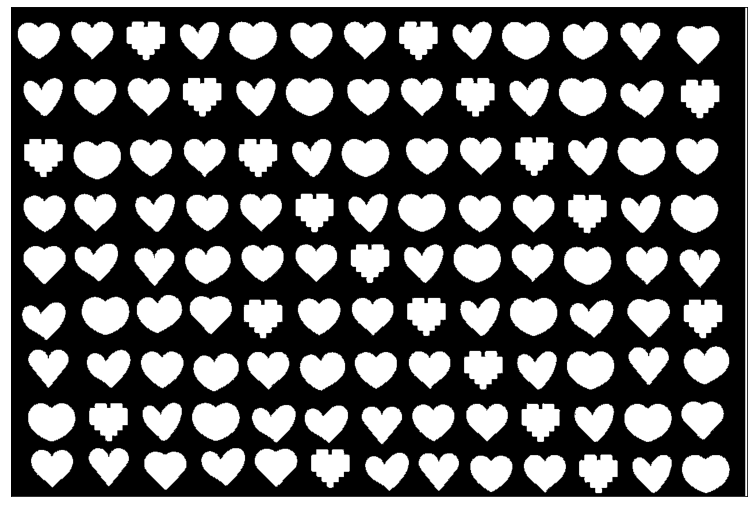

In [78]:
_, th = cv2.threshold(sobels, 50, 255, cv2.THRESH_BINARY)

im_floodfill = th.copy()
h, w = th.shape[:2]
mask = np.zeros((h+2, w+2), np.uint8)
cv2.floodFill(im_floodfill, mask, (3, 3), 255)
im_floodfill_inv = cv2.bitwise_not(im_floodfill)
filled = th | im_floodfill_inv

plot_image(filled, gray=True)

### Inverting

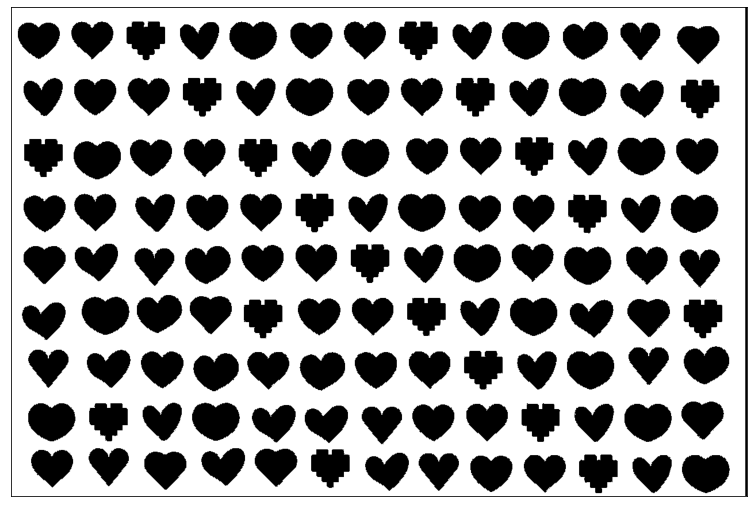

In [79]:
filled = 255 - filled
plot_image(filled, gray=True)

In [80]:
result.append(filled.copy())

## Results

In [81]:
for x in range(len(result)):
    cv2.imwrite("result/binary " + str(x + 1) + ".png", result[x])

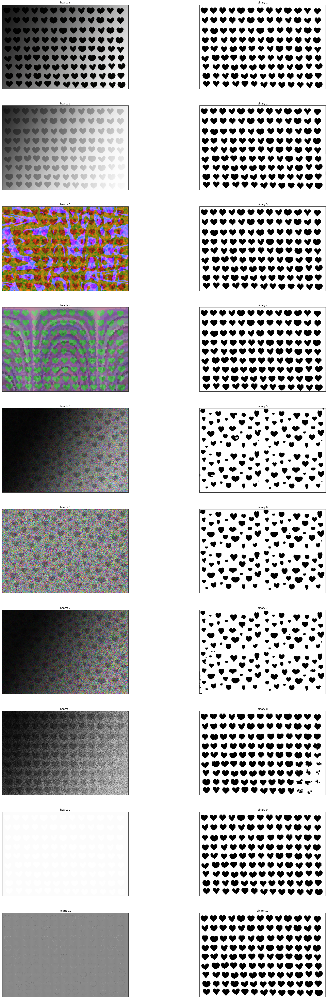

In [82]:
plt.rcParams["figure.figsize"] = (32, 90)
for x in range(10):
    plt.subplot(10, 2, 2 * x + 1)
    plt.imshow(images[x])
    plt.title("hearts " + str(x + 1))
    plt.xticks([])
    plt.yticks([])

    plt.subplot(10, 2, 2 * x + 2)
    plt.imshow(result[x], "gray")
    plt.title("binary " + str(x + 1))
    plt.xticks([])
    plt.yticks([])

Some more work can be done like filtering, adjusting parameters, removing artifacts near the borders.
## The End